In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/animals10/translate.py
/kaggle/input/animals10/raw-img/cavallo/OIP-mdvOxIWAyReAoEJcMk5z4wHaJ4.jpeg
/kaggle/input/animals10/raw-img/cavallo/OIP-TPYKs3XId_sMgp_6LLA6JgDMEy.jpeg
/kaggle/input/animals10/raw-img/cavallo/OIP-jlVRrokx7Vu1axi8OnTX2AHaE2.jpeg
/kaggle/input/animals10/raw-img/cavallo/OIP-F4QVZ71QagiynDMnFNxJUAHaEK.jpeg
/kaggle/input/animals10/raw-img/cavallo/OIP-UFtUZnXq0JHZo5R8UuF80wHaFj.jpeg
/kaggle/input/animals10/raw-img/cavallo/OIP-irWuWeIWd3Hm3BWGd0OEsQHaGO.jpeg
/kaggle/input/animals10/raw-img/cavallo/OIP-Y-hB14A3coI7TEgrEew0UAHaFj.jpeg
/kaggle/input/animals10/raw-img/cavallo/OIP-KqeKmYfnRwKd89nLg8_zRAHaHb.jpeg
/kaggle/input/animals10/raw-img/cavallo/OIP-s40xdXSQY099gt1hLGlzAwHaFP.jpeg
/kaggle/input/animals10/raw-img/cavallo/OIP-4k_sWoJ4_9-G1f0emDBVtwHaE6.jpeg
/kaggle/input/animals10/raw-img/cavallo/OIP-W-uUxHx-yovp1DQNtX1qdQHaFk.jpeg
/kaggle/input/animals10/raw-img/cavallo/OIP-Npxx8kemjjTljUyT9-BQgAHaFi.jpeg
/kaggle/input/animals10/raw-img/cavallo/OIP-jCu7nlv

In [2]:
import os
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import shutil  # used for managing files and directories in a cross-platform manner
import tensorflow as tf # used for loading pre-trained models from
from tensorflow.keras.preprocessing.image import ImageDataGenerator # used for image data augmentation
# Model architecture
from keras import Sequential  # used for building sequential models
from keras.models import load_model  # used for loading pre-trained models
from keras.layers import Dense, GlobalAvgPool2D as GAP, Dropout,MaxPooling2D,BatchNormalization  # used for defining model layers

# Training callbacks 
from keras.callbacks import ModelCheckpoint, EarlyStopping  # for training callbacks

# Pre-trained models
from tensorflow.keras.applications import ResNet152V2  # For using pre-trained models


2024-06-02 10:57:31.473962: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-06-02 10:57:31.474071: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-06-02 10:57:31.601986: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


Path Dataset dan melihat jumlah kelas nya

In [3]:
# giving path to the animals10 image dataset from kaggle 
data_path = '/kaggle/input/animals10/raw-img'

# Geting a list of all unique class names from the dataset path
class_names = sorted(os.listdir(data_path))

# Counting the number of classes
num_classes = len(class_names)

# Printing the class names and the total number of classes
print("Class Names: \n", class_names)
print("Number of Classes:", num_classes)

Class Names: 
 ['cane', 'cavallo', 'elefante', 'farfalla', 'gallina', 'gatto', 'mucca', 'pecora', 'ragno', 'scoiattolo']
Number of Classes: 10


Melihat distribusi kelas

In [4]:
# Geting the number of samples in each class (number of images per class)
class_sizes = []
for name in class_names:
    class_size = len(os.listdir(data_path + "/" + name))
    class_sizes.append(class_size)
    
# Printing the class distribution
print("Class Distribution:\n", class_sizes)

Class Distribution:
 [4863, 2623, 1446, 2112, 3098, 1668, 1866, 1820, 4821, 1862]


In [6]:
#  converting lists to dictionary
class_name_size = dict(zip(class_names, class_sizes))

In [7]:
# printing dictionary
class_name_size 

{'cane': 4863,
 'cavallo': 2623,
 'elefante': 1446,
 'farfalla': 2112,
 'gallina': 3098,
 'gatto': 1668,
 'mucca': 1866,
 'pecora': 1820,
 'ragno': 4821,
 'scoiattolo': 1862}

Memvisualisasikan distribusi kelas dengan seaborn

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1765: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)


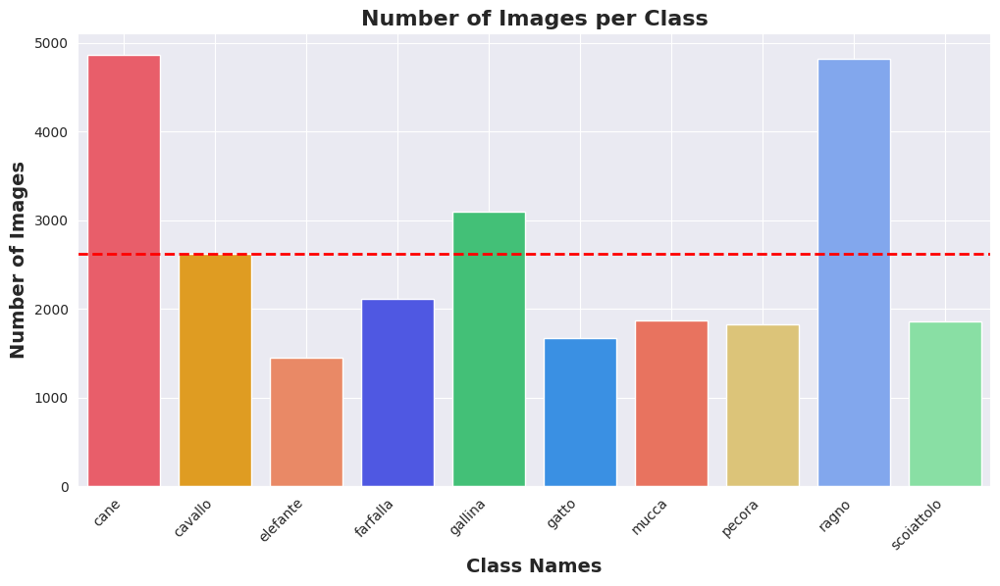

In [8]:
# Custom color palette
custom_palette = ['#ff4757', '#ffa502', '#ff7f50', '#3742fa', '#2ed573', 
                  '#1e90ff', '#ff6348', '#eccc68', '#70a1ff', '#7bed9f']

# Setting the style of seaborn
sns.set_style("darkgrid")

# Sets the size of the figure
plt.figure(figsize=(12,6))

# Ploting a bar chart using the class names as the x-axis and class sizes as the y-axis
sns.barplot(x=class_names, y=class_sizes, palette=custom_palette)

# Adding a grid to the plot for better readability
plt.grid(True)

# Adding a horizontal line to show the mean number of images across all classes
mean_value = np.mean(class_sizes)
plt.axhline(mean_value, color='red', linestyle='--', linewidth=2, label=f"Average: {mean_value:.2f}")

# setting x and y labels
plt.xlabel("Class Names", fontsize=14, weight='bold')
plt.ylabel("Number of Images", fontsize=14, weight='bold')

# preventing overlap
plt.xticks(rotation=45, ha='right')

# Setting the title of the graph
plt.title("Number of Images per Class", fontsize=16, weight='bold')

# Printing the plot
plt.show()


In [9]:
# getting minimum class size
np.min(class_sizes)

1446

Membuat direktori baru untuk data pre processing

In [10]:
# Path to the new directory
new_directory = '/kaggle/working/balance'

# Create the new directory
os.makedirs(new_directory, exist_ok=True)

# Check if the directory is created
if os.path.exists(new_directory):
    print(f"Directory '{new_directory}' created successfully!")
else:
    print(f"Failed to create directory '{new_directory}'!")

Directory '/kaggle/working/balance' created successfully!


Data Preprocessing untuk menyesuaikan jumlah gambar ke masing-masing kelas

In [11]:
# handling Data Imbalance

# Setting the path to the directory where the sampled data will be saved
sampled_data_path = r'/kaggle/working/balance'

# Creating the sampled data directory if it doesn't exist
if not os.path.exists(sampled_data_path):
    os.makedirs(sampled_data_path)

# Setting the percentage of each class to sample
sample_percent = 0.1

# Defining a dictionary that maps the original class names to their English names
class_names_dict = {
    'cane': 'dog',
    'cavallo': 'horse',
    'elefante': 'elephant',
    'farfalla': 'butterfly',
    'gallina': 'chicken',
    'gatto': 'cat',
    'mucca': 'cow',
    'pecora': 'sheep',
    'ragno': 'spider',
    'scoiattolo': 'squirrel'
}

# Looping through each class directory and copy 2000 images or less to the sampled data directory
for class_name in os.listdir(data_path):
    # Geting the path to the original class directory
    class_path = os.path.join(data_path, class_name)
    # Geting the English name of the class
    class_name_en = class_names_dict[class_name]
    # Geting the path to the sampled class directory
    sampled_class_path = os.path.join(sampled_data_path, class_name_en)
    # Creaing the sampled class directory and fill it up only if it doesn't exist ********
    if not os.path.exists(sampled_class_path):
        os.mkdir(sampled_class_path)
        # Geting a list of all the image files in the class directory
        image_files = os.listdir(class_path)
        # Calculating the number of images to sample **************
        image_class_size = class_name_size[class_name]
        if image_class_size > 2000:
            num_images = 2000
        else:
            num_images = int(image_class_size)
        # Samplimg the images
        sampled_images = np.random.choice(image_files, size=num_images, replace=False)
        # Copying the sampled images to the sampled class directory
        for image_name in sampled_images:
            src_path = os.path.join(class_path, image_name)
            dst_path = os.path.join(sampled_class_path, image_name)
            shutil.copyfile(src_path, dst_path)

Melihat apakah dataset sudah rata antar kelas

In [28]:
# Getting the Balanced dataset

sampled_data_path = r'/kaggle/working/balance'

# Geting a list of class names from the sampled data directory
class_names = sorted(os.listdir(sampled_data_path))

# Geting the number of samples in each class
class_sizes = []
for name in class_names:
    # Get the number of samples in the class directory
    class_size = len(os.listdir(os.path.join(sampled_data_path, name)))
    class_sizes.append(class_size)
    
# Printing the balanced class distribution
print("Class Distribution:\n", class_sizes)

Class Distribution:
 [2000, 1668, 2000, 1866, 2000, 1446, 2000, 1820, 2000, 1862]


Memvisualisasikannya lagi

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1765: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)


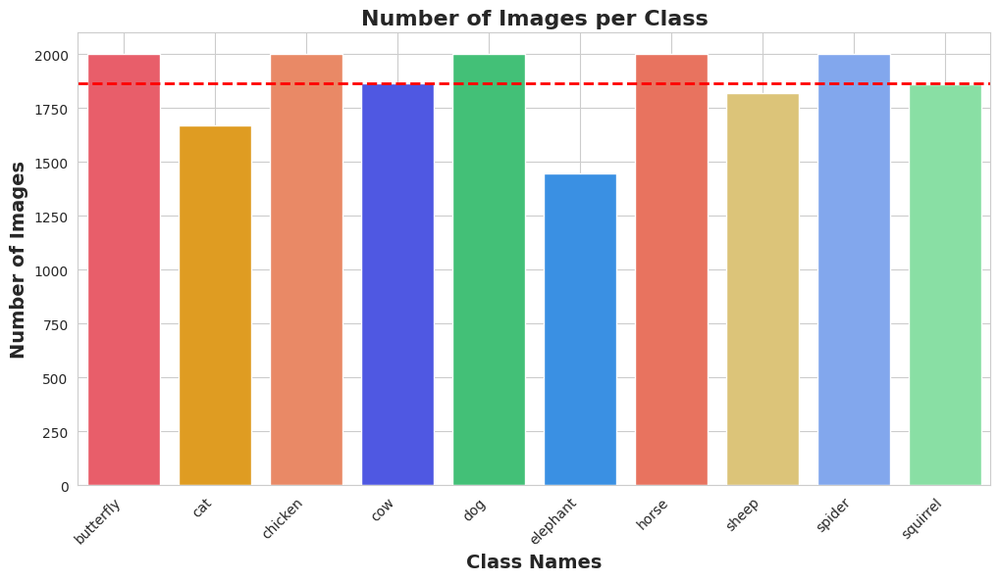

In [17]:
# Custom palette
custom_palette = ['#ff4757', '#ffa502', '#ff7f50', '#3742fa', '#2ed573', 
                  '#1e90ff', '#ff6348', '#eccc68', '#70a1ff', '#7bed9f']

# Seting the style of seaborn
sns.set_style("whitegrid")

# Seting the size of the figure
plt.figure(figsize=(12,6))

# Ploting a bar chart using the class names as the x-axis and class sizes as the y-axis
sns.barplot(x=class_names, y=class_sizes, palette=custom_palette) 

# Adding a grid to the plot for better readability
plt.grid(True)

# Adding a horizontal line to show the mean number of images across all classes
mean_value = np.mean(class_sizes)
plt.axhline(mean_value, color='red', linestyle='--', linewidth=2, label=f"Average: {mean_value:.2f}")

# setting of x and y labels
plt.xlabel("Class Names", fontsize=14, weight='bold')
plt.ylabel("Number of Images", fontsize=14, weight='bold')

# Rotating x labels to prevent overlap
plt.xticks(rotation=45, ha='right')

# Setting the title of the graph
plt.title("Number of Images per Class", fontsize=16, weight='bold')

# printing the plot
plt.show()

Membuat data generator dan mengaugmentasi dataset
membagi nya menjadi 80% training dan 20% validasi

In [29]:
# Data Augmentation

data_generator = ImageDataGenerator( # Initializing image data generator with the specified image transformations and preprocessing
    rescale=1./255, # rescale: normalizes pixel values from 0-255 to 0-1
    horizontal_flip=True, # horizontal_flip: randomly flips images horizontally
    vertical_flip=True, # vertical_flip: randomly flips images vertically
    rotation_range=20, # rotation_range: randomly rotates images by a given range in degrees
    validation_split=0.2) # validation_split: splits the data into training and validation sets, with 20% of the data used for validation

train_data = data_generator.flow_from_directory( 
    sampled_data_path, # Load training data from the specified directory and apply the generator
    target_size=(256,256), # target_size: resizes the images to a specified size
    class_mode='binary', # class_mode: specifies the type of label encoding, categorical for multiple classes
    batch_size=32, # batch_size: specifies the number of samples per batch
    shuffle=True, # shuffle: shuffles the data after each epoch
    subset='training')  # subset: specifies the subset of data to load, in this case, the Training set

valid_data = data_generator.flow_from_directory(
    sampled_data_path, # Load validation data from the specified directory and apply the generator
    target_size=(256,256), 
    class_mode='binary', # class_mode: specifies the type of label encoding, categorical for multiple classes
    batch_size=32, 
    shuffle=True, 
    subset='validation') # subset: specifies the subset of data to load validation data


Found 14931 images belonging to 10 classes.
Found 3731 images belonging to 10 classes.


In [20]:
def get_random_data(data_tuple):
    """
    Function to get a random data point from a given dataset.

    Args:
    data_tuple (tuple): A tuple containing the dataset images and labels as numpy arrays.

    Returns:
    A random image and its corresponding label as numpy arrays.
    """
    images, labels = data_tuple
    # geting a random index for an image in the dataset
    idx = np.random.randint(len(images))

    # selecting the image and its corresponding label using the random index
    image, label = images[idx], labels[idx]

    # returning the selected image and label
    return image, label

In [21]:
def show_image(image, image_title=None):
    '''
    This function takes in an image and an optional title and plots the image.
    '''
    # Display the image
    plt.imshow(image)
    
    # Set the title of the plot if provided
    plt.title(image_title)
    
    # Turn off the axes in the plot
    plt.axis('off')

Menampilkan beberapa dataset dan nama kelas nya

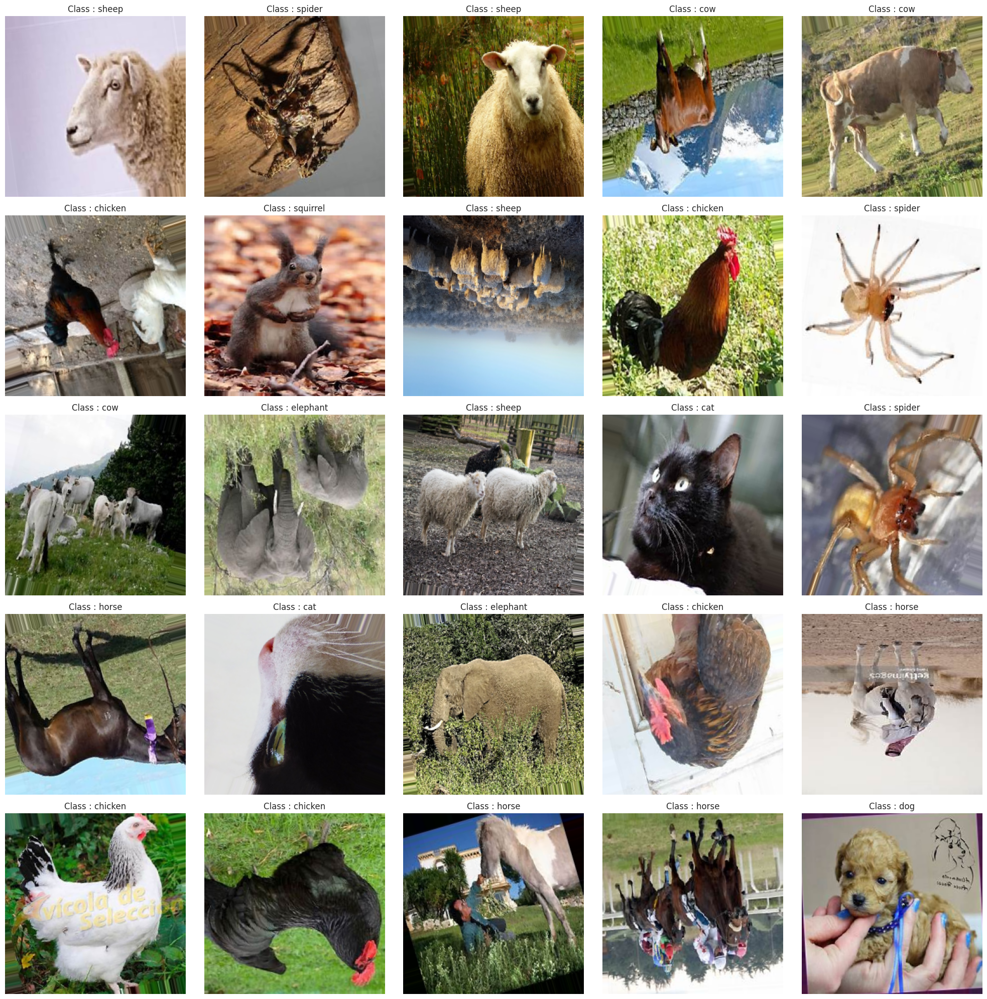

In [22]:
# Setting the figure size for the plot
plt.figure(figsize=(20,20))

# Initializing a counter for the subplots
counter=1

# Looping over the train dataset
for images, labels in iter(train_data):
    
    # Getting a random image and label
    image, label = get_random_data([images, labels])
    
    # Plotting the image with its class name as the title
    plt.subplot(5,5,counter)
    show_image(image, image_title=f"Class : {class_names[int(label)]}")
    
    # Increment the counter
    counter+=1
    
    # End the loop when 25 images have been plotted
    if counter>=26: break

# Adjusting the layout and displaying the plot
plt.tight_layout()
plt.show()

membuat eraly stopping agar dapat menghentikan iterasi jika tidak ada perubahan yang signifikan sekaligus mencegah overfitting

In [31]:
cbs = [
    EarlyStopping(patience=3, restore_best_weights=True),
    ModelCheckpoint(name + ".keras", save_best_only=True)
]

Memakai layer arsitektur ResNet152V2

In [24]:
# giving the name of the model as "ResNet152V2".
name = "ResNet152V2"

# Loading the pre-trained ResNet152V2 model, freeze its weights and exclude its final classification layer.
base_model = ResNet152V2(include_top=False, input_shape=(256,256,3), weights='imagenet')
base_model.trainable = False

234545216/234545216 ━━━━━━━━━━━━━━━━━━━━ 2s 0us/step


In [32]:
# Creating a sequential model with the ResNet152V2 base model, a global average pooling layer, two fully connected layers, MaxPooling layer,BatchNormalization layer,and a final softmax classification layer.
resnet152V2 = Sequential([
    base_model, #Adding ResNet152V2 base model
    MaxPooling2D(pool_size=(2, 2)),  # Adding Max Pooling with a 2x2 window
    BatchNormalization(),  # Adding Batch Normalization
    GAP(), # global average pooling layer to reduce dimension and parameters without losing important features
    Dense(256, activation='relu'), #
    Dropout(0.2), # adding droupout layer to prevent overfitting
    Dense(num_classes, activation='softmax')
], name=name)

Mengcompile Model

In [33]:
resnet152V2.compile(
    loss='sparse_categorical_crossentropy',
    optimizer='adam',
    metrics=['accuracy']
)

In [34]:
resnet152V2.summary()

Model: "squirrel"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ resnet152v2 (Functional)        │ ?                      │    58,331,648 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ ?                      │   0 (unbuilt) │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ ?                      │   0 (unbuilt) │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_1      │ ?                      │   0 (unbuilt) │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ ?                      │   0 (unbuilt) │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ ?                      │   0 (unbuilt) │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ ?                      │   0 (unbuilt) │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 58,331,648 (222.52 MB)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 58,331,648 (222.52 MB)

Memulai modelling

In [35]:
history = resnet152V2.fit(
    train_data, 
    validation_data=valid_data,
    epochs=50, 
    callbacks=cbs
)

Epoch 1/50


/opt/conda/lib/python3.10/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


  1/467 ━━━━━━━━━━━━━━━━━━━━ 4:42:21 36s/step - accuracy: 0.1875 - loss: 2.4110

I0000 00:00:1717326518.111177     113 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


467/467 ━━━━━━━━━━━━━━━━━━━━ 311s 588ms/step - accuracy: 0.8179 - loss: 0.5632 - val_accuracy: 0.9174 - val_loss: 0.2554
Epoch 2/50
467/467 ━━━━━━━━━━━━━━━━━━━━ 255s 539ms/step - accuracy: 0.9207 - loss: 0.2461 - val_accuracy: 0.9161 - val_loss: 0.2411
Epoch 3/50
467/467 ━━━━━━━━━━━━━━━━━━━━ 248s 525ms/step - accuracy: 0.9267 - loss: 0.2323 - val_accuracy: 0.9180 - val_loss: 0.2507
Epoch 4/50
467/467 ━━━━━━━━━━━━━━━━━━━━ 256s 541ms/step - accuracy: 0.9271 - loss: 0.2137 - val_accuracy: 0.9239 - val_loss: 0.2320
Epoch 5/50
467/467 ━━━━━━━━━━━━━━━━━━━━ 249s 527ms/step - accuracy: 0.9351 - loss: 0.1898 - val_accuracy: 0.9244 - val_loss: 0.2416
Epoch 6/50
467/467 ━━━━━━━━━━━━━━━━━━━━ 252s 534ms/step - accuracy: 0.9353 - loss: 0.1852 - val_accuracy: 0.9263 - val_loss: 0.2237
Epoch 7/50
467/467 ━━━━━━━━━━━━━━━━━━━━ 248s 524ms/step - accuracy: 0.9478 - loss: 0.1591 - val_accuracy: 0.9295 - val_loss: 0.2323
Epoch 8/50
467/467 ━━━━━━━━━━━━━━━━━━━━ 254s 537ms/step - accuracy: 0.9509 - loss: 0.14

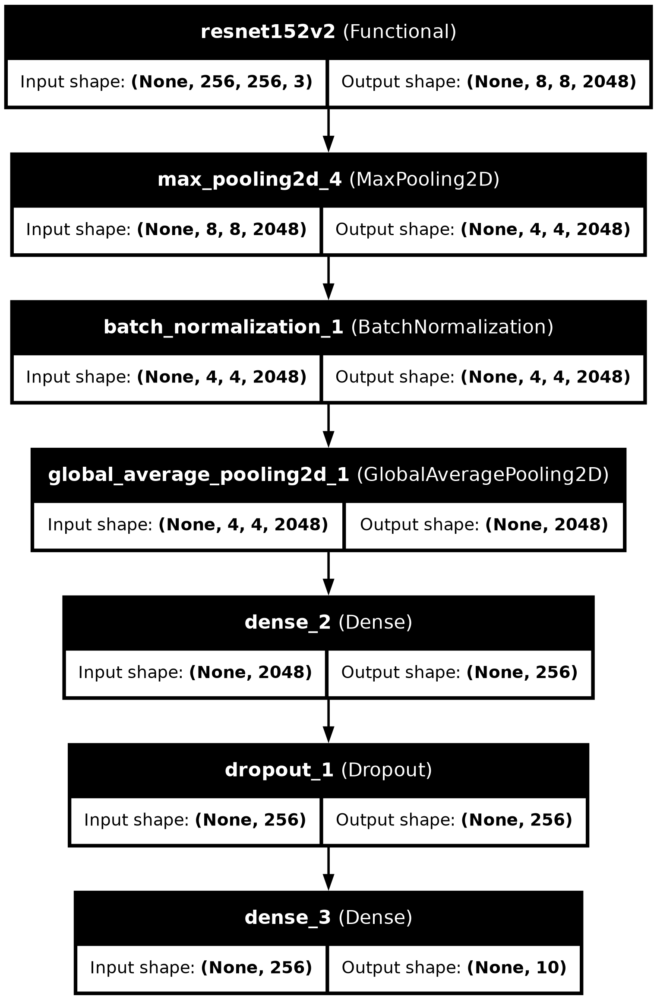

In [36]:
from tensorflow.keras.utils import plot_model

plot_model(resnet152V2, to_file='model_visualization.png', show_shapes=True, show_layer_names=True)

Melihat Akurasi

In [38]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report

# Evaluating the model to get loss and accuracy
val_loss, val_accuracy = resnet152V2.evaluate(valid_data, verbose=1)
print(f'Validation Loss: {val_loss}, Validation Accuracy: {val_accuracy}')

# Predicting on the validation set
predictions = resnet152V2.predict(valid_data)
predicted_classes = np.argmax(predictions, axis=1)
true_classes = valid_data.classes
class_labels = list(valid_data.class_indices.keys())


117/117 ━━━━━━━━━━━━━━━━━━━━ 49s 420ms/step - accuracy: 0.9227 - loss: 0.2508
Validation Loss: 0.2536867558956146, Validation Accuracy: 0.9233449697494507
117/117 ━━━━━━━━━━━━━━━━━━━━ 67s 492ms/step


Membandingkan validasi dan loss dengan grafik

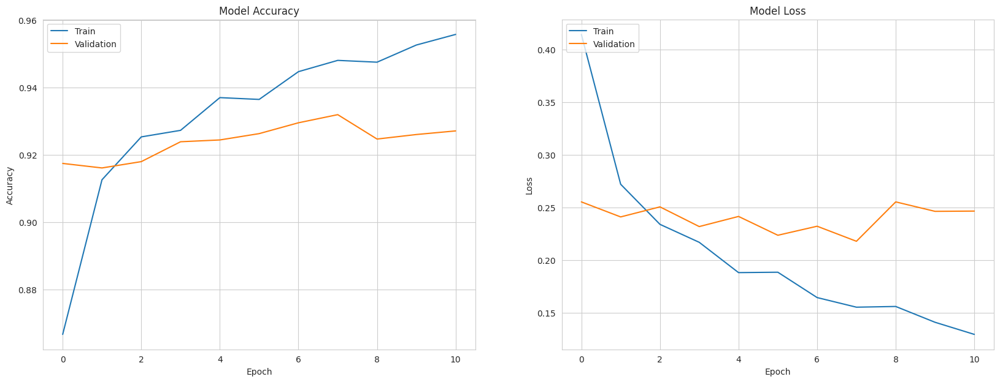

In [41]:
# Plotting training/validation loss and accuracy for bias-variance analysis
def plot_training_history(history):
    fig, ax = plt.subplots(1, 2, figsize=(20, 7))
    
    # Summarize history for accuracy
    ax[0].plot(history.history['accuracy'])
    ax[0].plot(history.history['val_accuracy'])
    ax[0].set_title('Model Accuracy')
    ax[0].set_ylabel('Accuracy')
    ax[0].set_xlabel('Epoch')
    ax[0].legend(['Train', 'Validation'], loc='upper left')
    
    # Summarize history for loss
    ax[1].plot(history.history['loss'])
    ax[1].plot(history.history['val_loss'])
    ax[1].set_title('Model Loss')
    ax[1].set_ylabel('Loss')
    ax[1].set_xlabel('Epoch')
    ax[1].legend(['Train', 'Validation'], loc='upper left')
    
    plt.show()

plot_training_history(history)

memvalidasi untuk mendapatkan metrik dengan 100 batch pertama

In [48]:
from sklearn.metrics import precision_score, recall_score, f1_score
import numpy as np

# Initializing lists to store true labels and predictions
y_true = []
y_pred = []

# Processing the first 100 batches from the validation data
for i, batch in enumerate(valid_data):
    if i >= 100:
        break
    
    inputs, labels = batch
    preds = resnet152V2.predict(inputs)

    preds = np.argmax(preds, axis=-1)

    y_true.extend(labels)
    y_pred.extend(preds)

# Convert collected true labels and predictions into numpy arrays
y_true = np.array(y_true)
y_pred = np.array(y_pred)

# Calculating Precision, Recall, and F1 Score using 'macro' average for multiclass classification
precision = precision_score(y_true, y_pred, average='macro')
recall = recall_score(y_true, y_pred, average='macro')
f1 = f1_score(y_true, y_pred, average='macro')

print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"F1 Score: {f1}")


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━

memvalidasi untuk mendapatkan metrik dengan 200 batch pertama, dapat dilihat hasilnya tetap konsiisten

In [49]:
from sklearn.metrics import precision_score, recall_score, f1_score
import numpy as np

# Initializing lists to store true labels and predictions
y_true = []
y_pred = []

# Processing the first 200 batches from the validation data
for i, batch in enumerate(valid_data):
    if i >= 200:
        break
    
    inputs, labels = batch
    preds = resnet152V2.predict(inputs)

    preds = np.argmax(preds, axis=-1)

    y_true.extend(labels)
    y_pred.extend(preds)

# Convert collected true labels and predictions into numpy arrays
y_true = np.array(y_true)
y_pred = np.array(y_pred)

# Calculating Precision, Recall, and F1 Score using 'macro' average for multiclass classification
precision = precision_score(y_true, y_pred, average='macro')
recall = recall_score(y_true, y_pred, average='macro')
f1 = f1_score(y_true, y_pred, average='macro')

print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"F1 Score: {f1}")


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━

Memvisualisasikan hasil metrik nya

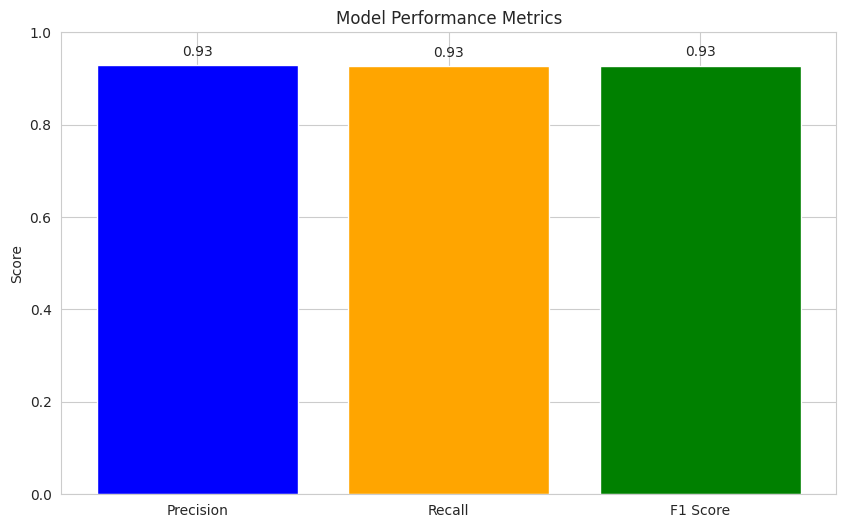

In [53]:
import matplotlib.pyplot as plt

# Metrics
metrics = ['Precision', 'Recall', 'F1 Score']
values = [precision, recall, f1]

# Creating bar chart
plt.figure(figsize=(10, 6))
plt.bar(metrics, values, color=['blue', 'orange', 'green'])

# Adding titles and labels
plt.title('Model Performance Metrics')
plt.ylabel('Score')
plt.ylim(0, 1)  # Since these metrics range from 0 to 1

# Displaying the values on top of the bars
for i, value in enumerate(values):
    plt.text(i, value + 0.02, f"{value:.2f}", ha='center')

# printing the plot
plt.show()

Mencoba mengetest model menggunakan dataset validasi

1/1 ━━━━━━━━━━━━━━━━━━━━ 7s 7s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


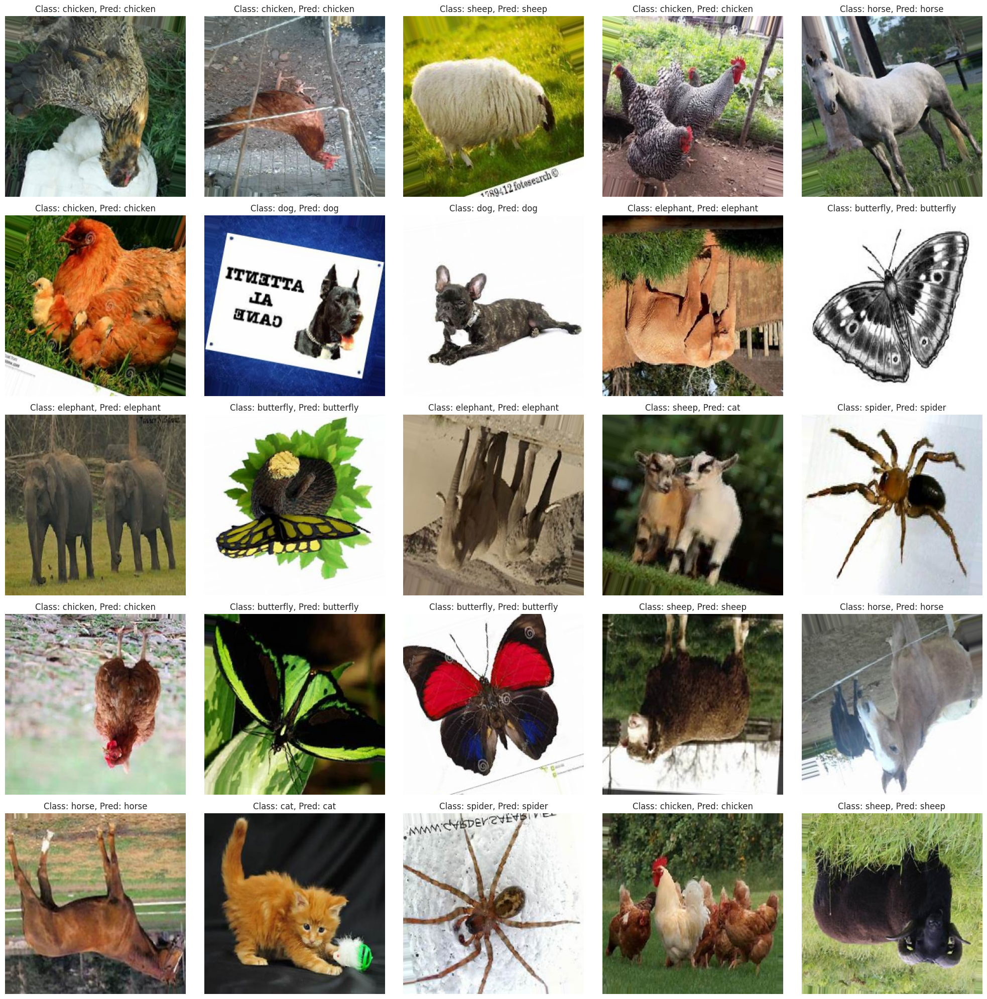

In [52]:
plt.figure(figsize=(20,20))
i=1
for images, labels in iter(valid_data):
    
    # Get Random Image and label
    image, label = get_random_data([images, labels])
    pred_label = class_names[np.argmax(resnet152V2.predict(image[np.newaxis,...]))]
    
    # Plot it
    plt.subplot(5,5,i)
    show_image(image)  # Call show_image without the title parameter
    plt.title(f"Class: {class_names[int(label)]}, Pred: {pred_label}")  # Set the title using plt.title
    
    # Make sure to end the loop
    i += 1
    if i >= 26: 
        break

plt.tight_layout()
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


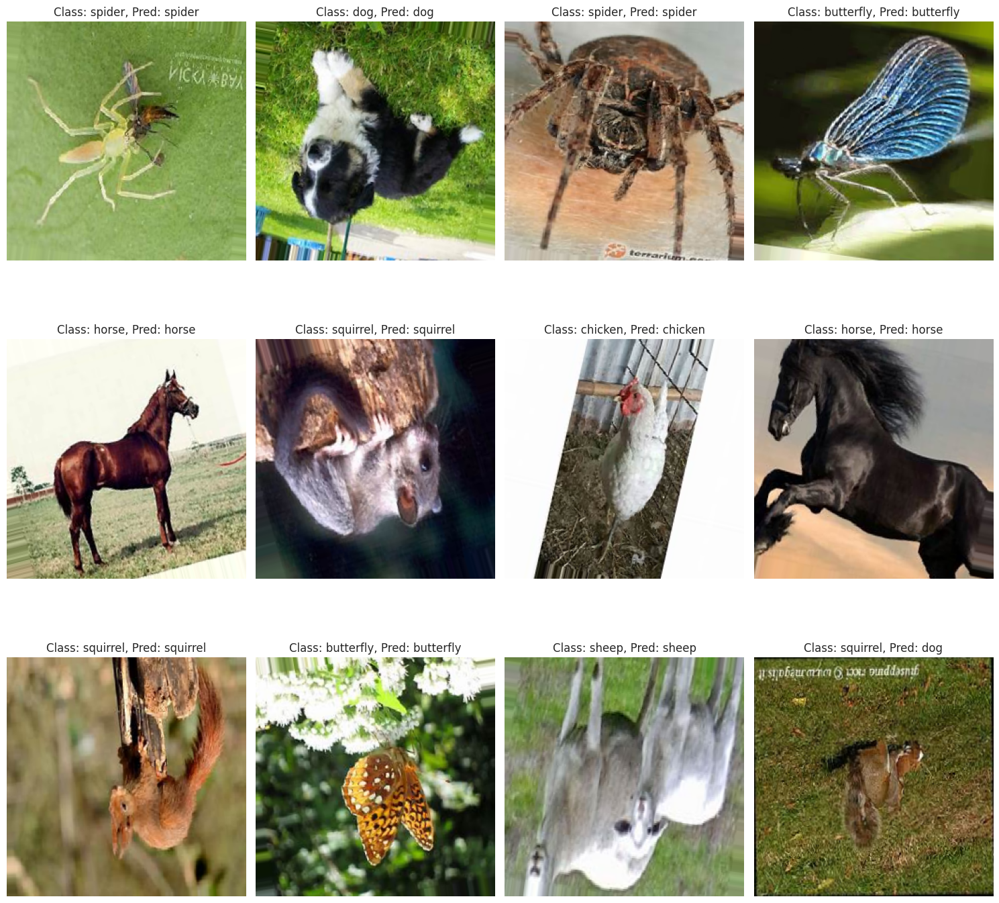

In [55]:
import matplotlib.pyplot as plt

plt.figure(figsize=(15,15))  # Set the figure size to make the images larger

i = 1
for images, labels in valid_data:
    # Get Random Image and label
    image, label = get_random_data([images, labels])
    pred_label = class_names[np.argmax(resnet152V2.predict(image[np.newaxis,...]))]
    
    # Plot it
    plt.subplot(3, 4, i)  # Adjust the subplot layout accordingly
    show_image(image)  # Call show_image without the title parameter
    plt.title(f"Class: {class_names[int(label)]}, Pred: {pred_label}")  # Set the title using plt.title
    
    # Increment the counter
    i += 1
    
    # Break the loop if 10 images are already shown
    if i > 12: 
        break

plt.tight_layout()
plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


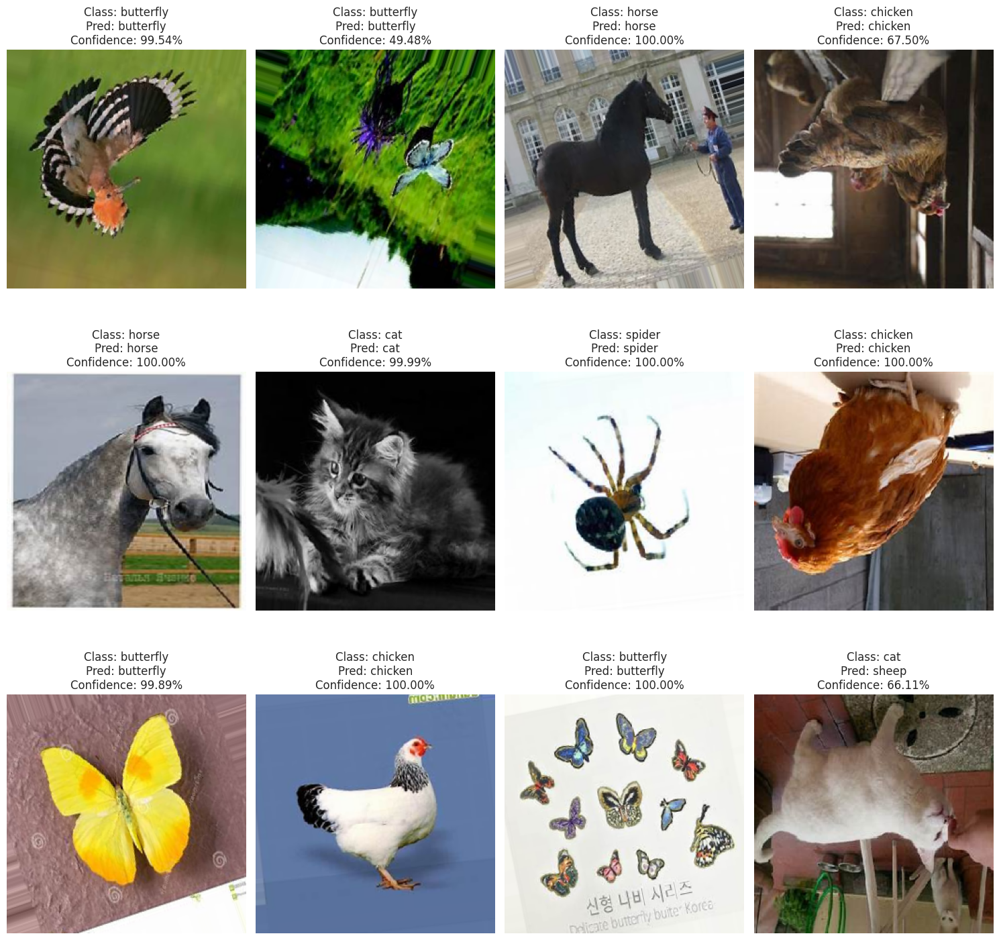

In [57]:
import matplotlib.pyplot as plt

plt.figure(figsize=(15,15))  # Set the figure size to make the images larger

i = 1
for images, labels in valid_data:
    # Get Random Image and label
    image, label = get_random_data([images, labels])
    predictions = resnet152V2.predict(image[np.newaxis,...])
    pred_label = class_names[np.argmax(predictions)]
    confidence = np.max(predictions) * 100
    
    # Plot it
    plt.subplot(3, 4, i)  # Adjust the subplot layout accordingly
    show_image(image)  # Call show_image without the title parameter
    plt.title(f"Class: {class_names[int(label)]}\nPred: {pred_label}\nConfidence: {confidence:.2f}%")  # Set the title using plt.title
    
    # Increment the counter
    i += 1
    
    # Break the loop if 10 images are already shown
    if i > 12: 
        break

plt.tight_layout()
plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


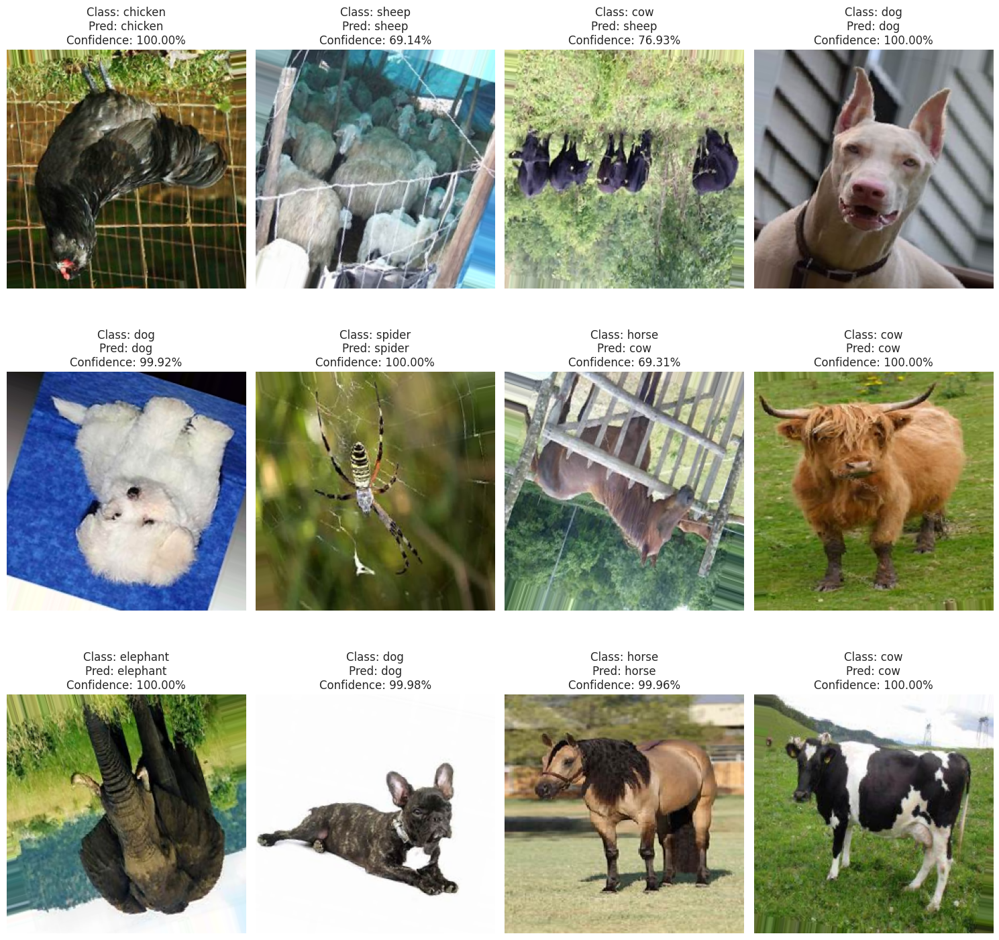

In [58]:
import matplotlib.pyplot as plt

plt.figure(figsize=(15,15))  # Set the figure size to make the images larger

i = 1
for images, labels in valid_data:
    # Get Random Image and label
    image, label = get_random_data([images, labels])
    predictions = resnet152V2.predict(image[np.newaxis,...])
    pred_label = class_names[np.argmax(predictions)]
    confidence = np.max(predictions) * 100
    
    # Plot it
    plt.subplot(3, 4, i)  # Adjust the subplot layout accordingly
    show_image(image)  # Call show_image without the title parameter
    plt.title(f"Class: {class_names[int(label)]}\nPred: {pred_label}\nConfidence: {confidence:.2f}%")  # Set the title using plt.title
    
    # Increment the counter
    i += 1
    
    # Break the loop if 10 images are already shown
    if i > 12: 
        break

plt.tight_layout()
plt.show()


In [75]:
# Menyimpan model ke direktori output Kaggle
resnet152V2.save('/kaggle/working/my_model.h5')

# Menambahkan model sebagai output
from IPython.display import FileLink
FileLink(r'my_model.h5')


/kaggle/working/my_model.h5

In [72]:
import os

# Nama dataset yang ingin Anda periksa
dataset_name = 'cat-and-butterfly'

# Path dataset
dataset_path = f'/kaggle/input/{dataset_name}'

# Mencetak path untuk dataset 'cat-and-butterfly'
for dirname, _, filenames in os.walk(dataset_path):
    for filename in filenames:
        print(os.path.join(dirname, filename))


/kaggle/input/cat-and-butterfly/kupukupu.jpeg
/kaggle/input/cat-and-butterfly/kucing.jpeg


Mencoba mengetest model dengan gambar external hasil jepretan sendiri/bukan dari google

1/1 ━━━━━━━━━━━━━━━━━━━━ 8s 8s/step


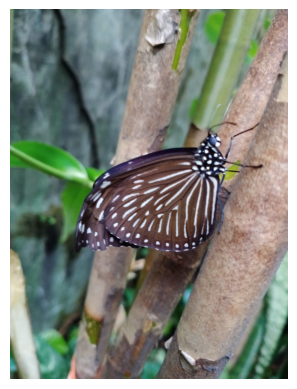

Prediksi Kelas: 0
Confidence: 100.0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


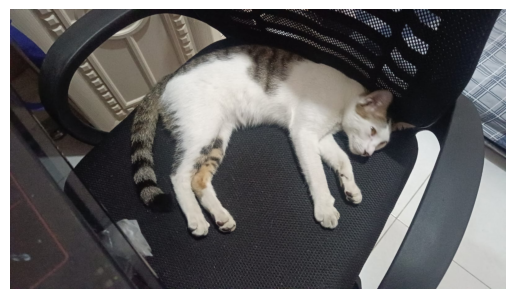

Prediksi Kelas: 1
Confidence: 99.99610185623169


In [73]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Path gambar-gambar dari dataset "cat-and-butterfly"
image_paths = [
    '/kaggle/input/cat-and-butterfly/kupukupu.jpeg',
    '/kaggle/input/cat-and-butterfly/kucing.jpeg',
]

# Memuat model dari file yang diunggah
model = load_model('/kaggle/working/my_model.h5')  # Sesuaikan dengan path model Anda

for image_path in image_paths:
    # Memuat gambar
    image = cv2.imread(image_path)

    # Pra-pemrosesan gambar (sesuaikan dengan format input yang diharapkan oleh model)
    # Contoh: resize gambar menjadi ukuran yang diharapkan oleh model
    image = cv2.resize(image, (256, 256))  # Ganti (256, 256) dengan ukuran yang sesuai

    # Normalisasi gambar (jika diperlukan)
    image_normalized = image / 255.0  # Normalisasi pixel nilai menjadi 0-1

    # Menambahkan dimensi tambahan untuk membuat batch
    image_normalized = np.expand_dims(image_normalized, axis=0)

    # Melakukan prediksi
    predictions = model.predict(image_normalized)

    # Mengambil label kelas prediksi (jika keluaran model adalah one-hot encoded)
    predicted_class = np.argmax(predictions)

    # Menghitung confidence level
    confidence = np.max(predictions) * 100

    # Menampilkan gambar yang diunggah
    img = cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.axis('off')
    plt.show()

    # Menampilkan hasil prediksi
    print("Prediksi Kelas:", predicted_class)
    print("Confidence:", confidence)


mengecek kelas

In [70]:
for i, class_name in enumerate(class_names):
    print(f"Kelas {i}: {class_name}")


Kelas 0: butterfly
Kelas 1: cat
Kelas 2: chicken
Kelas 3: cow
Kelas 4: dog
Kelas 5: elephant
Kelas 6: horse
Kelas 7: sheep
Kelas 8: spider
Kelas 9: squirrel


mengetest menggunakan kelas yang sudah di cek

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


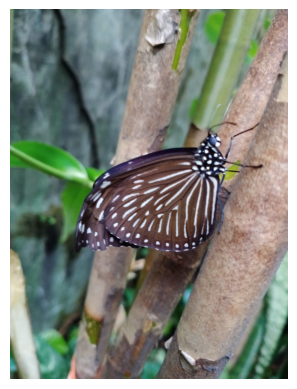

Prediksi Kelas: kupukupu
Confidence: 100.0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


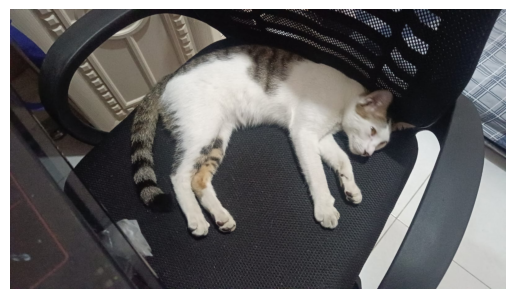

Prediksi Kelas: kucing
Confidence: 99.99610185623169


In [74]:
# Dictionary untuk mengonversi nomor kelas menjadi label kelas
class_labels = {
    0: 'kupukupu',
    1: 'kucing',
    2: 'chicken',
    3: 'cow',
    4: 'dog',
    5: 'elephant',
    6: 'horse',
    7: 'sheep',
    8: 'spider',
    9: 'squirrel'
}


for image_path in image_paths:
    # Memuat gambar
    image = cv2.imread(image_path)

    # Pra-pemrosesan gambar (sesuaikan dengan format input yang diharapkan oleh model)
    # Contoh: resize gambar menjadi ukuran yang diharapkan oleh model
    image = cv2.resize(image, (256, 256))  # Ganti (256, 256) dengan ukuran yang sesuai

    # Normalisasi gambar (jika diperlukan)
    image_normalized = image / 255.0  # Normalisasi pixel nilai menjadi 0-1

    # Menambahkan dimensi tambahan untuk membuat batch
    image_normalized = np.expand_dims(image_normalized, axis=0)

    # Melakukan prediksi
    predictions = model.predict(image_normalized)

    # Mengambil label kelas prediksi (jika keluaran model adalah one-hot encoded)
    predicted_class = np.argmax(predictions)

    # Menghitung confidence level
    confidence = np.max(predictions) * 100

    # Menampilkan gambar yang diunggah
    img = cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.axis('off')
    plt.show()

    # Menampilkan hasil prediksi
    predicted_label = class_labels.get(predicted_class, 'Unknown')
    print("Prediksi Kelas:", predicted_label)
    print("Confidence:", confidence)
